___

<a href='http://www.pieriandata.com'> <img src='../Pierian_Data_Logo.png' /></a>
___

# Finance Data Project

In this data project we will focus on exploratory data analysis of stock prices. Keep in mind, this project is just meant to practice your visualization and pandas skills, it is not meant to be a robust financial analysis or be taken as financial advice.
____
** NOTE: This project is extremely challenging because it will introduce a lot of new concepts and have you looking things up on your own (we'll point you in the right direction) to try to solve the tasks issued. Feel free to just go through the solutions lecture notebook and video as a "walkthrough" project if you don't want to have to look things up yourself. You'll still learn a lot that way! **
____
We'll focus on bank stocks and see how they progressed throughout the [financial crisis](https://en.wikipedia.org/wiki/Financial_crisis_of_2007%E2%80%9308) all the way to early 2016.

## Get the Data

In this section we will learn how to use pandas to directly read data from Google finance using pandas!

First we need to start with the proper imports, which we've already laid out for you here.

*Note: [You'll need to install pandas-datareader for this to work!](https://github.com/pydata/pandas-datareader) Pandas datareader allows you to [read stock information directly from the internet](http://pandas.pydata.org/pandas-docs/stable/remote_data.html) Use these links for install guidance (**pip install pandas-datareader**), or just follow along with the video lecture.*

### The Imports

Already filled out for you.

In [ ]:
#Dong 1
from pandas_datareader import data, wb
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime
%matplotlib inline

## Data

We need to get data using pandas datareader. We will get stock information for the following banks:
*  Bank of America
* CitiGroup
* Goldman Sachs
* JPMorgan Chase
* Morgan Stanley
* Wells Fargo

** Figure out how to get the stock data from Jan 1st 2006 to Jan 1st 2016 for each of these banks. Set each bank to be a separate dataframe, with the variable name for that bank being its ticker symbol. This will involve a few steps:**
1. Use datetime to set start and end datetime objects.
2. Figure out the ticker symbol for each bank.
2. Figure out how to use datareader to grab info on the stock.

** Use [this documentation page](https://pandas-datareader.readthedocs.io/en/latest/remote_data.html) for hints and instructions (it should just be a matter of replacing certain values. Use google finance as a source, for example:**
    
    # Bank of America
    BAC = data.DataReader("BAC", 'google', start, end)

### WARNING: MAKE SURE TO CHECK THE LINK ABOVE FOR THE LATEST WORKING API. "google" MAY NOT ALWAYS WORK.
------------
### We also provide pickle file in the article lecture right before the video lectures.

In [ ]:
#Dong 2
start=datetime.datetime(2006,1,1)
end=datetime.datetime(2016,1,1)

In [ ]:
#Dong 3
#BAC = data.DataReader("BAC", "stooq", start, end)
BAC = data.DataReader("BAC.US", 'stooq', start, end)
C = data.DataReader("C.US", "stooq", start, end)
GS = data.DataReader("GS.US", "stooq", start, end)
JPM = data.DataReader("JPM.US", "stooq", start, end)
MS = data.DataReader("MS.US", "stooq", start, end)
WFC = data.DataReader("WFC.US", "stooq", start, end)

In [ ]:
#Dong 4
df=data.DataReader(['BAC','C','GS','JPM','MS','WFC'],'stooq',start,end)

** Create a list of the ticker symbols (as strings) in alphabetical order. Call this list: tickers**

In [ ]:
#Dong 5
tickers=['BAC','C','GS','JPM','MS','WFC']

** Use pd.concat to concatenate the bank dataframes together to a single data frame called bank_stocks. Set the keys argument equal to the tickers list. Also pay attention to what axis you concatenate on.**

In [ ]:
#Dong 6
bank_stocks=pd.concat([BAC,C,GS,JPM,MS,WFC],keys=tickers,axis=1)
bank_stocks.head(5)

BAC                                                 C  \
               Open     High      Low    Close        Volume     Open   
Date                                                                    
2006-01-03  39.4871  39.7023  38.8390  39.6217  1.936396e+07  405.492   
2006-01-04  39.5549  39.7592  39.0904  39.2004  2.110031e+07  404.358   
2006-01-05  39.2004  39.4126  38.9834  39.2525  1.761312e+07  400.843   
2006-01-06  39.3850  39.4774  39.0089  39.1917  1.496529e+07  404.504   
2006-01-09  39.3182  39.5294  39.0158  39.2181  1.855918e+07  402.174   

                                                     ...       MS           \
               High      Low    Close        Volume  ...     Open     High   
Date                                                 ...                     
2006-01-03  408.615  398.112  407.891  1.858097e+06  ...  37.4934  38.3558   
2006-01-04  406.325  400.089  400.354  2.260921e+06  ...  38.4971  38.8778   
2006-01-05  403.663  400.520  402.321  1.371893e+06  ...  38.2675  38.4264   
2006-01-06  404.641  398.865  402.321  1.655812e+06  ...  38.5432  38.5922   
2006-01-09  403.329  399.678  400.432  2.031072e+06  ...  38.4470  38.8846   

                                                WFC                    \
                Low    Close        Volume     Open     High      Low   
Date                                                                    
2006-01-03  37.2060  38.2361  6.806387e+06  22.7430  23.0144  22.4559   
2006-01-04  38.2675  38.2675  1.009857e+07  22.8831  22.8979  22.5683   
2006-01-05  38.0448  38.3715  7.313990e+06  22.6690  22.7055  22.5308   
2006-01-06  38.0703  38.4108  8.721337e+06  22.7302  22.8643  22.5920   
2006-01-09  38.4412  38.8120  5.246244e+06  22.7983  22.8979  22.7055   

                                   
              Close        Volume  
Date                               
2006-01-03  22.9581  1.530724e+07  
2006-01-04  22.6917  1.510382e+07  
2006-01-05  22.6690  1.407726e+07  
2006-01-06  22.7983  1.167705e+07  
2006-01-09  22.7983  7.808415e+06  

[5 rows x 30 columns]

** Set the column name levels (this is filled out for you):**

In [ ]:
#Dong 7
bank_stocks.columns.names = ['Bank Ticker','Stock Info']

** Check the head of the bank_stocks dataframe.**

In [ ]:
#Dong 8
bank_stocks.head(7)

Bank Ticker      BAC                                                 C  \
Stock Info      Open     High      Low    Close        Volume     Open   
Date                                                                     
2006-01-03   39.4871  39.7023  38.8390  39.6217  1.936396e+07  405.492   
2006-01-04   39.5549  39.7592  39.0904  39.2004  2.110031e+07  404.358   
2006-01-05   39.2004  39.4126  38.9834  39.2525  1.761312e+07  400.843   
2006-01-06   39.3850  39.4774  39.0089  39.1917  1.496529e+07  404.504   
2006-01-09   39.3182  39.5294  39.0158  39.2181  1.855918e+07  402.174   
2006-01-10   39.0502  39.1425  38.6132  38.8901  1.857689e+07  399.678   
2006-01-11   38.7644  38.9224  38.5022  38.7998  1.751688e+07  410.280   

Bank Ticker                                           ...       MS           \
Stock Info      High      Low    Close        Volume  ...     Open     High   
Date                                                  ...                     
2006-01-03   408.615  398.112  407.891  1.858097e+06  ...  37.4934  38.3558   
2006-01-04   406.325  400.089  400.354  2.260921e+06  ...  38.4971  38.8778   
2006-01-05   403.663  400.520  402.321  1.371893e+06  ...  38.2675  38.4264   
2006-01-06   404.641  398.865  402.321  1.655812e+06  ...  38.5432  38.5922   
2006-01-09   403.329  399.678  400.432  2.031072e+06  ...  38.4470  38.8846   
2006-01-10   401.763  397.867  401.685  1.650580e+06  ...  38.5922  38.8366   
2006-01-11   410.280  402.028  405.326  2.035419e+06  ...  38.7856  39.2702   

Bank Ticker                                      WFC                    \
Stock Info       Low    Close        Volume     Open     High      Low   
Date                                                                     
2006-01-03   37.2060  38.2361  6.806387e+06  22.7430  23.0144  22.4559   
2006-01-04   38.2675  38.2675  1.009857e+07  22.8831  22.8979  22.5683   
2006-01-05   38.0448  38.3715  7.313990e+06  22.6690  22.7055  22.5308   
2006-01-06   38.0703  38.4108  8.721337e+06  22.7302  22.8643  22.5920   
2006-01-09   38.4412  38.8120  5.246244e+06  22.7983  22.8979  22.7055   
2006-01-10   38.4196  38.8366  5.966637e+06  22.7055  22.7983  22.6344   
2006-01-11   38.5844  39.0632  7.389814e+06  22.7785  22.9542  22.7213   

Bank Ticker                         
Stock Info     Close        Volume  
Date                                
2006-01-03   22.9581  1.530724e+07  
2006-01-04   22.6917  1.510382e+07  
2006-01-05   22.6690  1.407726e+07  
2006-01-06   22.7983  1.167705e+07  
2006-01-09   22.7983  7.808415e+06  
2006-01-10   22.7785  9.945737e+06  
2006-01-11   22.8979  1.118127e+07  

[7 rows x 30 columns]

# EDA

Let's explore the data a bit! Before continuing, I encourage you to check out the documentation on [Multi-Level Indexing](http://pandas.pydata.org/pandas-docs/stable/advanced.html) and [Using .xs](http://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.xs.html).
Reference the solutions if you can not figure out how to use .xs(), since that will be a major part of this project.

** What is the max Close price for each bank's stock throughout the time period?**

In [ ]:
 #Dong 9
bank_stocks.xs(key='Close',axis=1,level='Stock Info').max()

Bank Ticker
BAC     46.2013
C      466.8120
GS     203.6910
JPM     57.1634
MS      58.5624
WFC     47.0925
dtype: float64

** Create a new empty DataFrame called returns. This dataframe will contain the returns for each bank's stock. returns are typically defined by:**

$$r_t = \frac{p_t - p_{t-1}}{p_{t-1}} = \frac{p_t}{p_{t-1}} - 1$$

In [ ]:
#Dong 10
returns=pd.DataFrame()

** We can use pandas pct_change() method on the Close column to create a column representing this return value. Create a for loop that goes and for each Bank Stock Ticker creates this returns column and set's it as a column in the returns DataFrame.**

In [ ]:
#Dong 11
for tick in tickers:
    returns[tick+'return']= bank_stocks[tick]['Close'].pct_change()
returns

,BACreturn,Creturn,GSreturn,JPMreturn,MSreturn,WFCreturn
Date,,,,,,
2006-01-03,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-04,-0.010633,-0.018478,-0.013704,-0.014304,0.000821,-0.011604
2006-01-05,0.001329,0.004913,-0.000364,0.003130,0.002718,-0.001000
2006-01-06,-0.001549,0.000000,0.013995,0.007061,0.001024,0.005704
2006-01-09,0.000674,-0.004695,0.012026,0.016240,0.010445,0.000000
...,...,...,...,...,...,...
2015-12-24,-0.004101,0.001453,-0.002507,-0.001915,-0.003609,-0.004024
2015-12-28,-0.008110,-0.006245,-0.004702,-0.003286,-0.009601,-0.002472
2015-12-29,0.008633,0.011509,0.010432,0.010303,0.011815,0.011086


** Create a pairplot using seaborn of the returns dataframe. What stock stands out to you? Can you figure out why?**

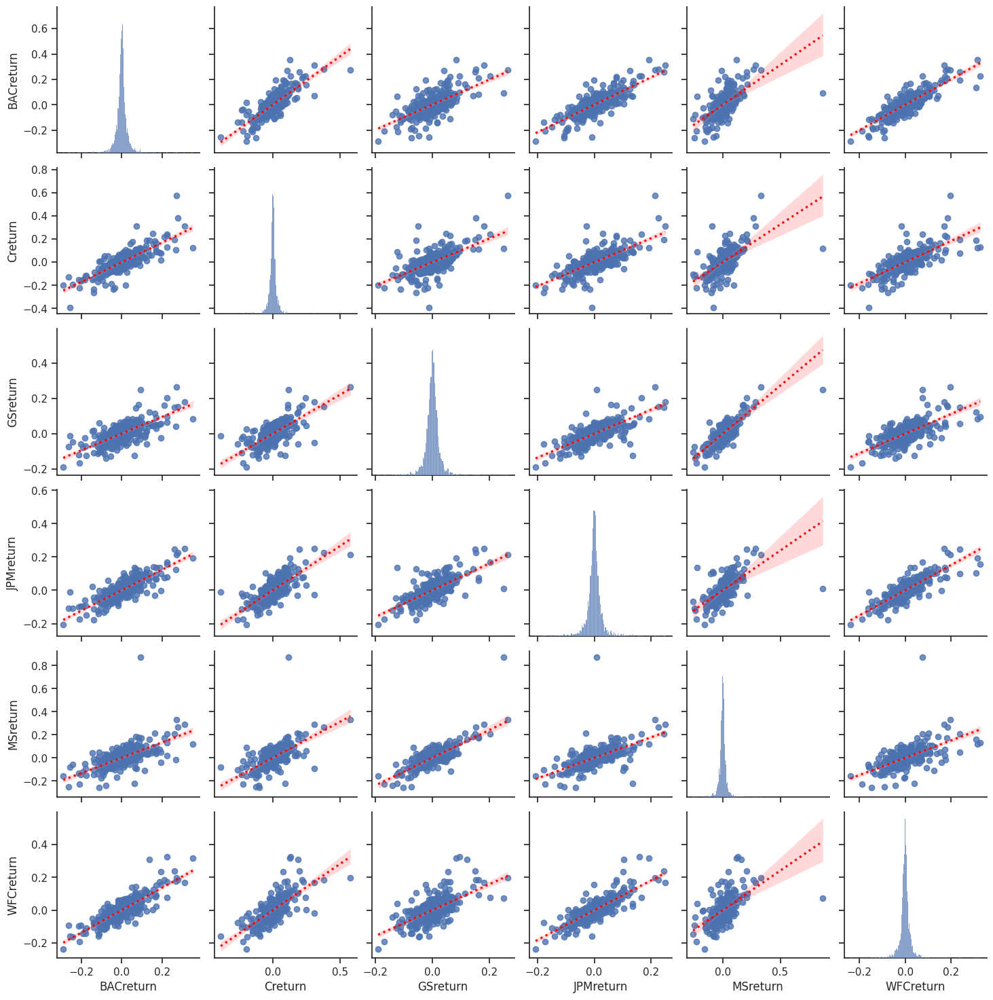

In [ ]:
#Dong 12
sns.set(style="ticks", color_codes=True)
sns.pairplot(returns[1:],kind="reg", plot_kws={'line_kws':{'color':'red', 'linestyle': ':'}})

* See solution for details about Citigroup behavior....

** Using this returns DataFrame, figure out on what dates each bank stock had the best and worst single day returns. You should notice that 4 of the banks share the same day for the worst drop, did anything significant happen that day?**

In [ ]:
#Dong 13
returns.idxmin()

BACreturn   2009-01-20
Creturn     2009-02-27
GSreturn    2009-01-20
JPMreturn   2009-01-20
MSreturn    2008-10-09
WFCreturn   2009-01-20
dtype: datetime64[ns]

** You should have noticed that Citigroup's largest drop and biggest gain were very close to one another, did anythign significant happen in that time frame? **

* See Solution for details

In [ ]:
#Dong 14
returns.idxmax()

BACreturn   2009-04-09
Creturn     2008-11-24
GSreturn    2008-11-24
JPMreturn   2009-01-21
MSreturn    2008-10-13
WFCreturn   2008-07-16
dtype: datetime64[ns]

** Take a look at the standard deviation of the returns, which stock would you classify as the riskiest over the entire time period? Which would you classify as the riskiest for the year 2015?**

In [ ]:
#Dong 15
returns.std()

BACreturn    0.036605
Creturn      0.038615
GSreturn     0.025371
JPMreturn    0.027670
MSreturn     0.037708
WFCreturn    0.030221
dtype: float64

In [ ]:
#Dong 16
returns.loc['2015-01-01':'2016-01-01'].std()

BACreturn    0.016149
Creturn      0.015280
GSreturn     0.014028
JPMreturn    0.013964
MSreturn     0.016006
WFCreturn    0.012545
dtype: float64

** Create a distplot using seaborn of the 2015 returns for Morgan Stanley **

<ipython-input-17-520a25fdc533>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(returns.loc['2015-01-01':'2016-01-01']['MSreturn'],color='green',bins=50)


<Axes: xlabel='MSreturn', ylabel='Density'>

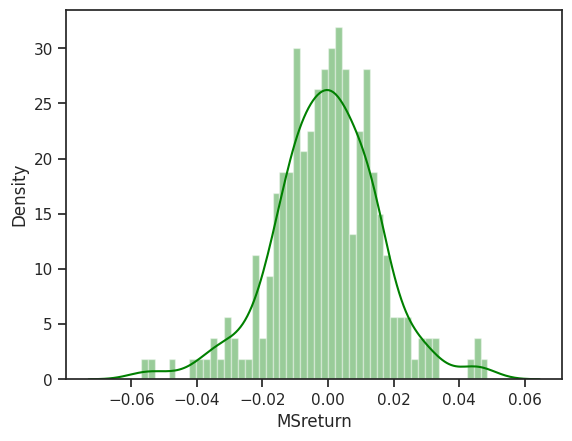

In [ ]:
#Dong 17
sns.distplot(returns.loc['2015-01-01':'2016-01-01']['MSreturn'],color='green',bins=50)

** Create a distplot using seaborn of the 2008 returns for CitiGroup **

<ipython-input-19-ec35dcc1900e>:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<Axes: xlabel='Creturn', ylabel='Density'>

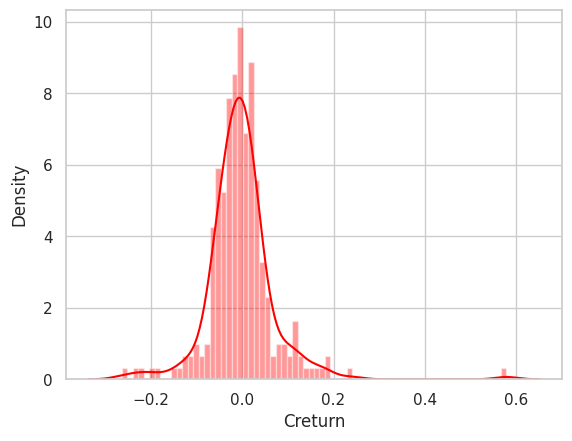

In [ ]:
#Dong 18
sns.distplot(returns.loc['2008-01-01':'2009-01-01']['Creturn'],color='red',bins=70)

____
# More Visualization

A lot of this project will focus on visualizations. Feel free to use any of your preferred visualization libraries to try to recreate the described plots below, seaborn, matplotlib, plotly and cufflinks, or just pandas.

### Imports

In [ ]:
#Dong 19
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline

# Optional Plotly Method Imports
import plotly
import cufflinks as cf
cf.go_offline()

** Create a line plot showing Close price for each bank for the entire index of time. (Hint: Try using a for loop, or use [.xs](http://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.xs.html) to get a cross section of the data.)**

Axes(0.125,0.2;0.775x0.68)
Axes(0.125,0.2;0.775x0.68)
Axes(0.125,0.2;0.775x0.68)
Axes(0.125,0.2;0.775x0.68)
Axes(0.125,0.2;0.775x0.68)
Axes(0.125,0.2;0.775x0.68)


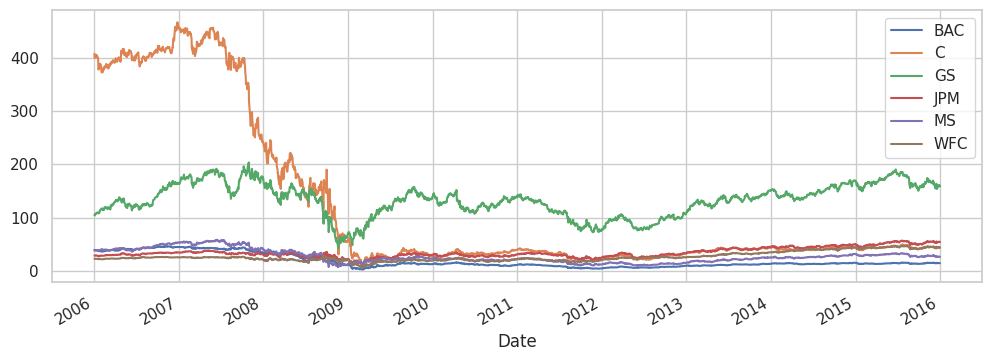

In [ ]:
#Dong 20
for tick in tickers:
    print(bank_stocks[tick]['Close'].plot(label=tick,figsize=(12,4)));
plt.legend()

<Axes: xlabel='Date'>

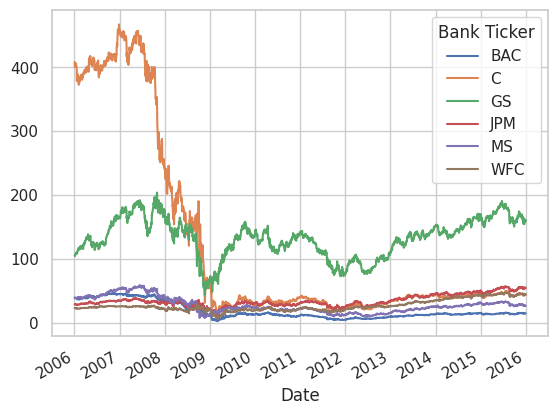

In [ ]:
#Dong 21
bank_stocks.xs(key='Close',axis=1,level='Stock Info').plot()

In [ ]:
#Dong 22
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
    '''))
    init_notebook_mode( connected=False )
import plotly
import cufflinks as cf
cf.go_offline()
enable_plotly_in_cell()

bank_stocks.xs(key='Close', axis=1, level='Stock Info').iplot()

## Moving Averages

Let's analyze the moving averages for these stocks in the year 2008.

** Plot the rolling 30 day average against the Close Price for Bank Of America's stock for the year 2008**

<ipython-input-24-36f57da09d55>:2: FutureWarning:

Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.

<ipython-input-24-36f57da09d55>:3: FutureWarning:

Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.



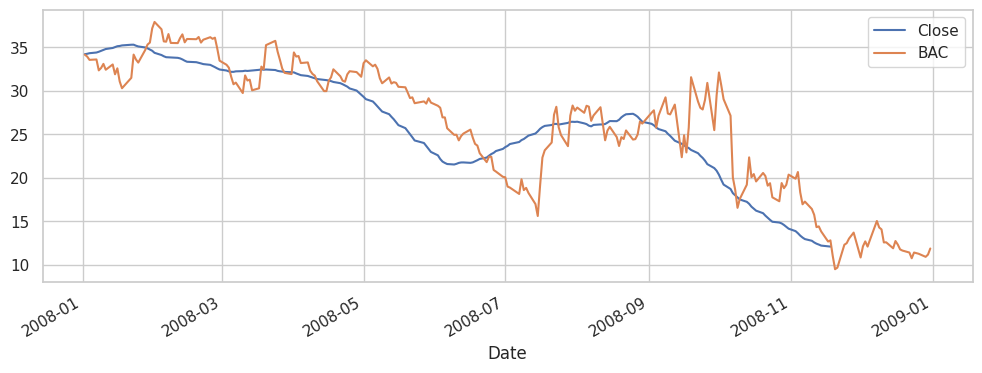

In [ ]:
#Dong 23
BAC['Close'].loc['2008-01-01':'2009-01-01'].rolling(window=30).mean().plot(figsize=(12,4))
BAC['Close'].loc['2008-01-01':'2009-01-01'].plot(label='BAC')
plt.legend()

** Create a heatmap of the correlation between the stocks Close Price.**

<Axes: xlabel='Bank Ticker', ylabel='Bank Ticker'>

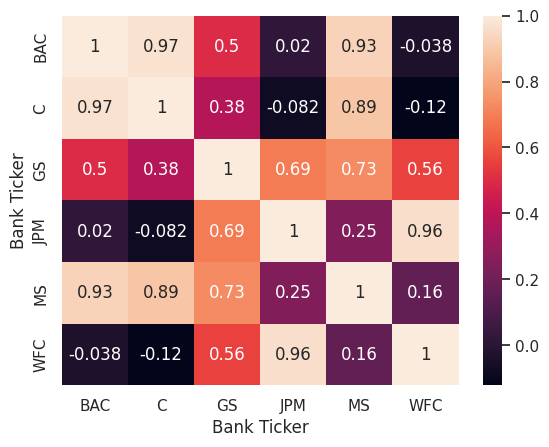

In [ ]:
#Dong 24
sns.heatmap(bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr(),annot=True)

** Optional: Use seaborn's clustermap to cluster the correlations together:**

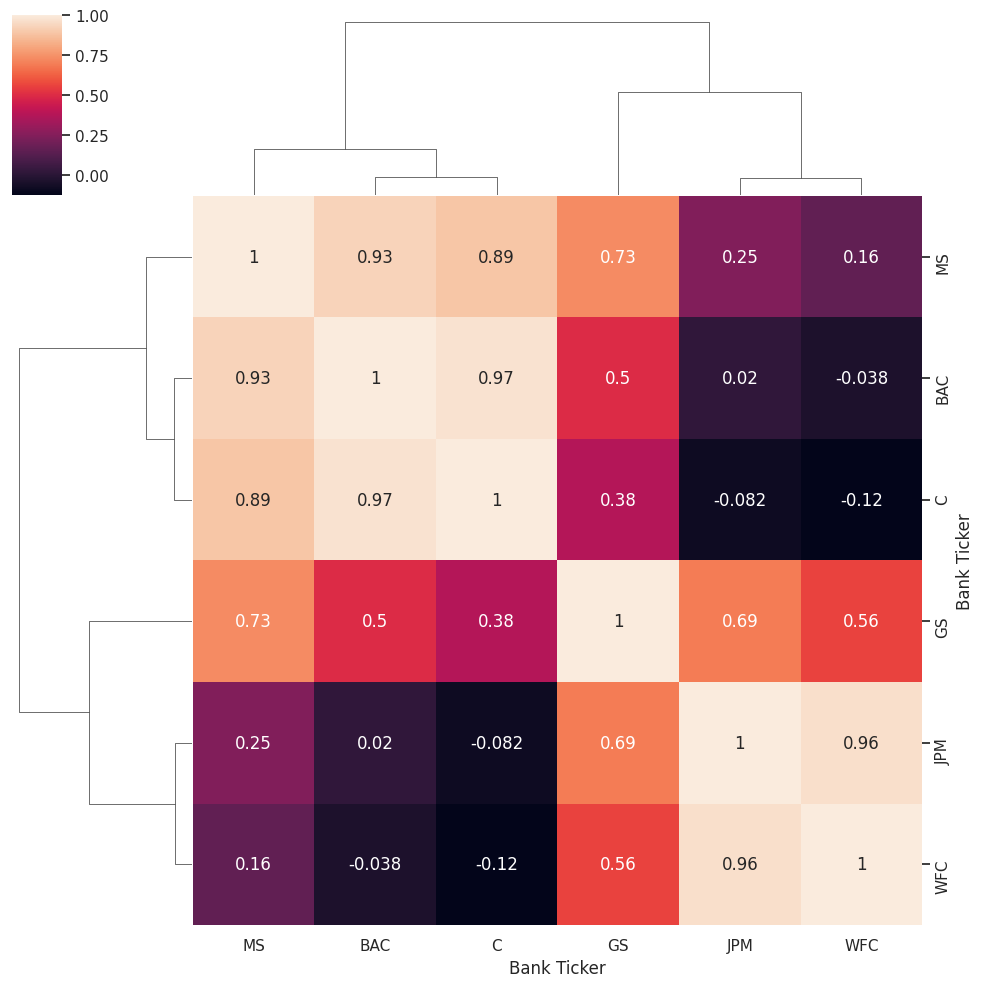

In [ ]:
#Dong 25
sns.clustermap(bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr(),annot=True)

In [ ]:
#Dong 26
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
    '''))
    init_notebook_mode( connected=False )
import plotly
import cufflinks as cf
cf.go_offline()
enable_plotly_in_cell()
close_corr = bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr()
close_corr.iplot(kind='heatmap',colorscale='rdylbu')

# Part 2 (Optional)

In this second part of the project we will rely on the cufflinks library to create some Technical Analysis plots. This part of the project is experimental due to its heavy reliance on the cuffinks project, so feel free to skip it if any functionality is broken in the future.

** Use .iplot(kind='candle) to create a candle plot of Bank of America's stock from Jan 1st 2015 to Jan 1st 2016.**

In [ ]:
#Dong 27
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
    '''))
    init_notebook_mode( connected=False )
import plotly
import cufflinks as cf
cf.go_offline()
enable_plotly_in_cell()
BAC[['Open', 'High', 'Low', 'Close']].loc['2015-01-01':'2016-01-01'].iplot(kind='candle')

<ipython-input-23-af53dbce8969>:13: FutureWarning:

Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.



** Use .ta_plot(study='sma') to create a Simple Moving Averages plot of Morgan Stanley for the year 2015.**

In [ ]:
#Dong 28
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
    '''))
    init_notebook_mode( connected=False )
import plotly
import cufflinks as cf
cf.go_offline()
enable_plotly_in_cell()
MS['Close'].loc['2015-01-01':'2016-01-01'].ta_plot(study='sma',periods=[13,34],title='Simple Moving Averages')

<ipython-input-30-bc7fc44edb30>:13: FutureWarning:

Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.



**Use .ta_plot(study='boll') to create a Bollinger Band Plot for Bank of America for the year 2015.**

In [ ]:
#Dong 29
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''
            <script src="/static/components/requirejs/require.js"></script>
    '''))
    init_notebook_mode( connected=False )
import plotly
import cufflinks as cf
cf.go_offline()
enable_plotly_in_cell()
BAC['Close'].loc['2015-01-01':'2016-01-01'].ta_plot(study='boll')

<ipython-input-30-9ba05e24c5ad>:13: FutureWarning:

Value based partial slicing on non-monotonic DatetimeIndexes with non-existing keys is deprecated and will raise a KeyError in a future Version.



# Great Job!

Definitely a lot of more specific finance topics here, so don't worry if you didn't understand them all! The only thing you should be concerned with understanding are the basic pandas and visualization oeprations.